# 4 Extract KMCCA components and scene categories

## Setup

In [1]:
import pandas as pd
from convergence.nsd import get_subject_roi, get_resource
from mvlearn.embed import KMCCA
import scipy.stats as stats
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
from tqdm import tqdm
from convergence.nsd import get_image

## Functions

In [3]:
def get_shared_stimulus(subject_i, subject_j, query=None):
    df_stimuli = get_resource("stimulus")
    if query is not None:
        df_stimuli = df_stimuli.query(query)
    df_1 = df_stimuli.query("subject == @subject_i and exists and shared")
    df_1 = df_1[["subject", "subject_index", "nsd_id", "repetition"]]
    df_2 = df_stimuli.query("subject == @subject_j and exists and shared")
    df_2 = df_2[["subject", "subject_index", "nsd_id", "repetition"]]
    df = pd.merge(df_1, df_2, on=["nsd_id", "repetition"], suffixes=("_i", "_j"))
    # Reorder
    columns = ["subject_i", "subject_j", "subject_index_i", "subject_index_j"]
    df = df[["nsd_id", "repetition"] + columns]

    return df


def get_shared_stimulus_subset(subjects, query=None, nsd_id_list=None):
    df_stimuli = get_resource("stimulus")
    if query is not None:
        df_stimuli = df_stimuli.query(query)

    if nsd_id_list is not None:
        df_stimuli = df_stimuli.query("nsd_id in @nsd_id_list")

    assert len(subjects) > 0
    subject_0 = subjects[0]
    df_shared = df_stimuli.query(f"subject == {subject_0} and exists and shared")
    df_shared = df_shared[["subject", "subject_index", "nsd_id", "repetition"]]
    df_shared.rename(
        columns={"subject": "subject_0", "subject_index": "subject_index_0"},
        inplace=True,
    )

    for i, subject in enumerate(subjects[1:]):

        df = df_stimuli.query(f"subject == {subject} and exists and shared")
        df = df[["subject", "subject_index", "nsd_id", "repetition"]]
        df.rename(
            columns={
                "subject": f"subject_{i+1}",
                "subject_index": f"subject_index_{i+1}",
            },
            inplace=True,
        )

        df_shared = pd.merge(df_shared, df, on=["nsd_id", "repetition"])

    return df_shared


def get_roi_by_name(names, hemisphere="both"):
    hcp = get_resource("hcp")
    if not isinstance(names, list):
        names = [names]
    rois = hcp[hcp.name.isin(names)].roi.tolist()
    if hemisphere == "right":
        rois = [roi for roi in rois if roi > 180]
    # if left only <180
    elif hemisphere == "left":
        rois = [roi for roi in rois if roi <= 180]
    return rois


def prepare_betas(betas, subject_index, q=0.03):
    betas_subject = betas[subject_index]
    a, b = np.quantile(betas_subject, [q, 1 - q])
    betas_subject = np.clip(betas_subject, a, b)
    betas_subject = (betas_subject - a) / (b - a)
    
    # Perform row mean normalization betas is n_stimuli x n_voxels
    betas_subject = betas_subject - np.mean(betas_subject, axis=1, keepdims=True)

    # Divide by the norm of each row
    norms = np.linalg.norm(betas_subject, axis=1, keepdims=True)
    norms[norms == 0] = 1  # Avoid division by zero
    betas_subject = betas_subject / norms

    return betas_subject


def load_variables(nsd_ids=None):
    info = get_resource("coco-objects")
    df_motion = pd.read_parquet(
        "/mnt/tecla/Results/convergence/captions/nsd-pixtral-motion-caption.parquet"
    )

    # pivot supercategory to columns nsd_id as index 1 if the supercategory is present 0 otherwise
    kind_object = "supercategory"
    info = info.drop_duplicates(subset=["nsd_id", kind_object])
    info = (
        info.pivot(index="nsd_id", columns=kind_object, values=kind_object)
        .notnull()
        .astype(int)
    )
    info = info.reset_index()
    df_motion["motion"] = (df_motion["caption"] == "motion").astype(int)
    df_motion["static"] = (df_motion["caption"] == "static").astype(int)
    df_motion = df_motion[["nsd_id", "motion", "static"]]
    info = pd.merge(info, df_motion, on="nsd_id", validate="one_to_one")

    if nsd_ids is not None:
        info = info.set_index("nsd_id")
        info = info.loc[nsd_ids]
        info = info.reset_index()

    return info
from PIL import Image, ImageDraw


def plot_atlas(
    embedding,
    nsd_id,
    figsize=(20, 20),
    image_size=0.03,
    pixel_size=80,
    axis=(0, 1),
    pbar=True,
    sample=None,
    color=None,
    dpi=100,
    outline_width=5,
):
    embedding = embedding[:, axis].copy()
    for j in range(2):
        embedding[:, j] -= embedding[:, j].min()
        embedding[:, j] /= embedding[:, j].max()

    nsd_id = np.asarray(nsd_id)
    if color is not None:
        color = np.asarray(color)

    if sample is not None:
        n = int(embedding.shape[0] * sample)
        idx = np.random.choice(embedding.shape[0], n, replace=False)
        embedding = embedding[idx]
        nsd_id = nsd_id[idx]
        if color is not None:
            color = color[idx]

    image_size = (image_size, image_size)
    pixel_size = (pixel_size, pixel_size)
    image_width, image_height = image_size

    iterator = list(enumerate(embedding))
    if pbar:
        iterator = tqdm(iterator, leave=False)

    fig, ax = plt.subplots(figsize=figsize, dpi=dpi)
    for i, (x, y) in iterator:
        img = get_image(nsd_id[i])
        img = img.resize(pixel_size, Image.Resampling.LANCZOS)  # Resize image
        if color is not None:
            draw = ImageDraw.Draw(img)
                # The rectangle uses pixel coordinates on the resized image
                # e.g. from (0, 0) to (width - 1, height - 1)
            draw.rectangle(
                [(0, 0), (pixel_size[0]-1, pixel_size[1]-1)],
                outline=color[i],
                width=outline_width
            )
        
            img = img.convert("RGB")
        imagebox = np.array(img)
        ax.imshow(
            imagebox,
            extent=(
                x - image_width / 2,
                x + image_width / 2,
                y - image_height / 2,
                y + image_height / 2,
            ),
            aspect="auto",
            zorder=2,
        )

    ax.set_xlim(-0.1, 1.1)
    ax.set_ylim(-0.1, 1.1)
    #ax.axis("off")
    sns.despine(ax=ax)
    ax.grid(False)
    iterator.close()
    return fig, ax


def get_subjects_cca(
    subjects,
    roi_names,
    n_components=2,
    regs=0.3,
    kernel="cosine",
    query=None,
    nsd_id_list=None,
    hemisphere="both",
    multiview_output=False,
    **kwargs,
):
    shared_stimuli = get_shared_stimulus_subset(
        subjects=subjects, query=query, nsd_id_list=nsd_id_list
    )

    hub_rois = get_roi_by_name(roi_names, hemisphere=hemisphere)

    betas = []
    for i, subject in enumerate(subjects):
        betas_subject = get_subject_roi(subject, hub_rois)
        subject_index = shared_stimuli[f"subject_index_{i}"].tolist()
        betas_subject = prepare_betas(betas_subject, subject_index=subject_index)
        betas.append(betas_subject)

    cca = KMCCA(
        n_components=n_components,
        regs=regs,
        kernel=kernel,
        n_jobs=-1,
        multiview_output=multiview_output,
        **kwargs,
    )
    projection = cca.fit_transform(betas)
    return projection, cca, shared_stimuli


def projection_to_df(projection, nsd_ids, group=True, add_variables=True):
    data = {"nsd_id": nsd_ids}
    if len(projection.shape) == 3:
        for subject in range(projection.shape[0]):
            for component in range(projection.shape[2]):
                data[f"cca_{subject+1}_{component+1}"] = projection[subject][
                    :, component
                ]
    else:
        for component in range(projection.shape[1]):
            data[f"cca_{component+1}"] = projection[:, component]
    data = pd.DataFrame(data)
    if group:
        data = data.groupby("nsd_id").mean().reset_index()

    if add_variables:
        df_variables = load_variables(nsd_ids).drop_duplicates(subset=["nsd_id"])
        data = pd.merge(data, df_variables, on="nsd_id")

    return data

## Compute MVKCCA

In [5]:
visual_cortex = ["V1", "V2", "V3", "V4"]
ventral_hub = ["PHA1", "PHA2", "PHA3", "VMV1", "VMV2", "VMV3", ]
dorsal_hub = ["MT", "MST", "V4t", "FST", "TPOJ2", "TPOJ3"]
other = ["VVC", "FFC", "V8", "TPOJ1"]
subjects = [1, 2, 3, 4, 5, 6, 7, 8]

df_variables = load_variables()
person_images = df_variables.query("person == 1 or animal == 1").nsd_id.tolist()

In [6]:
projections = []
hemisphere = "both"
results = []
roi_names = ["visual_cortex", "ventral_hub", "dorsal_hub"]
for i, roi in tqdm(list(enumerate([visual_cortex, ventral_hub, dorsal_hub]))):
    projection, cca, df_shared = get_subjects_cca(subjects=subjects, roi_names=roi, n_components=None, hemisphere=hemisphere)
    df_projection = projection_to_df(projection, df_shared.nsd_id)
    results.append((projection, cca, df_shared))
    df_projection["roi"] = roi_names[i]
    df_projection["hemisphere"] = hemisphere
    projections.append(df_projection)

df_projection = pd.concat(projections)
df_projection

100%|██████████| 3/3 [04:07<00:00, 82.41s/it] 


,nsd_id,cca_1,cca_2,cca_3,cca_4,cca_5,cca_6,cca_7,cca_8,cca_9,...,cca_767,cca_768,cca_769,cca_770,cca_771,cca_772,cca_773,cca_774,cca_775,cca_776
0,2950,0.015147,0.005718,-0.002859,-0.009698,0.004074,0.000668,-0.005822,0.008987,-0.004839,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2990,-0.013364,-0.002641,-0.007247,0.029068,0.003027,-0.005955,-0.010299,0.003683,-0.000995,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,3049,0.010049,0.008139,0.008482,0.003457,0.018966,0.004372,0.038299,-0.003953,0.016930,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3077,0.020082,-0.005623,-0.003923,0.004458,0.016964,-0.030197,0.011402,-0.005145,0.029485,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,3146,0.009405,0.004876,-0.022174,-0.037504,0.000472,-0.004445,-0.000362,0.001954,0.002106,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
902,72312,-0.010851,0.013335,-0.043371,0.009621,-0.024339,0.001340,-0.006752,-0.007406,-0.001244,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
903,72510,0.025454,-0.013963,-0.006877,-0.014001,-0.001455,0.000216,-0.020937,-0.011049,-0.007756,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
904,72605,-0.007145,0.006607,0.011688,0.002747,0.017631,-0.027819,-0.009535,-0.009029,0.015259,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
905,72719,0.023694,-0.000367,-0.007104,-0.001617,-0.001492,0.008357,-0.001436,-0.007552,-0.003003,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [11]:
df_projection.roi.unique()

array(['visual_cortex', 'ventral_hub', 'dorsal_hub'], dtype=object)

In [15]:
df_projection.to_parquet("projecctions_centered_cca_both.parquet", index=False)

<Axes: xlabel='cca_1', ylabel='cca_2'>

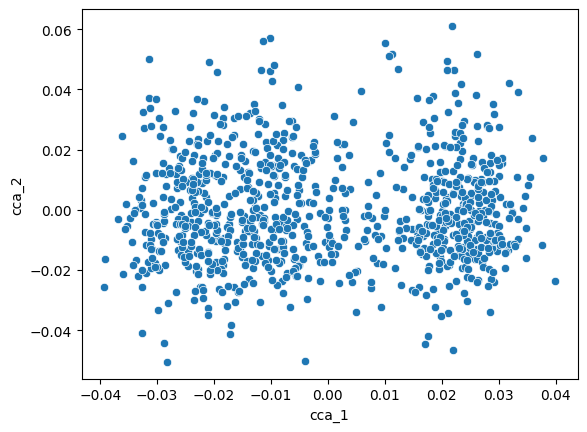

In [8]:
sns.scatterplot(data=df_projection.query("roi=='dorsal_hub'"), x="cca_1", y="cca_2")

6
3
2


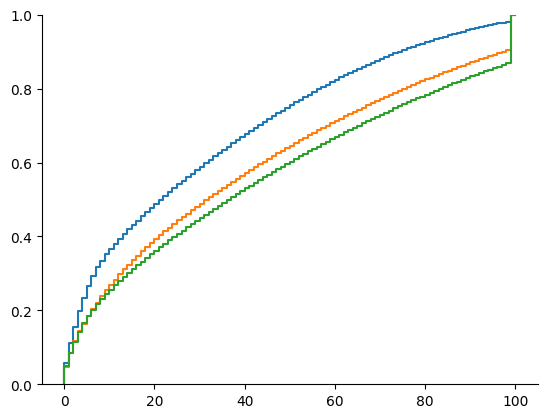

In [56]:
fig, ax = plt.subplots()
n_components = 100
for i in range(3):
    kmcca_fitted = results[i][1]
    eigenvalues = kmcca_fitted.evals_.copy()
    #eigenvalues = np.clip(eigenvalues, 0, None) # Minimal errors
    shared_variance = eigenvalues / np.sum(eigenvalues)
    # Truncate -> Take the first n_components. 
    # Create an array with real valeus from 0 to n_components and summ the rest
    # to the last element

    shared_variance_truncated = shared_variance[:n_components].copy()
    shared_variance_truncated[-1] += np.sum(shared_variance[n_components:])
    
    ax.step(x=range(n_components+1), y=[0, *shared_variance_truncated.cumsum()], color=f"C{i}")
    print(np.argmax(shared_variance < 0.03))
ax.set_ylim(0, 1)
    
sns.despine(ax=ax)

#ax.set_xscale("log")

In [57]:
eigenvalues

array([ 7.6790233 ,  5.41333838,  4.55981732,  3.94441972,  3.75049391,
        3.05949913,  2.63975507,  2.27761362,  2.13752182,  1.95822896,
        1.92306902,  1.82475575,  1.79197392,  1.72815   ,  1.6372665 ,
        1.62463784,  1.57640973,  1.54642819,  1.53775964,  1.50873188,
        1.49316646,  1.4656044 ,  1.41913816,  1.41218956,  1.39955197,
        1.36950755,  1.35504189,  1.34233281,  1.32257005,  1.31494844,
        1.29019489,  1.28874464,  1.27490507,  1.26421425,  1.25276893,
        1.23602772,  1.22766264,  1.20316158,  1.20022505,  1.18389468,
        1.17847569,  1.16576106,  1.15766605,  1.14432424,  1.13963988,
        1.12682433,  1.11488452,  1.11039518,  1.09087001,  1.08043472,
        1.07132697,  1.06634581,  1.04453905,  1.04042239,  1.0300984 ,
        1.02197842,  1.01795148,  1.00143317,  0.99841611,  0.98592636,
        0.97848013,  0.96985352,  0.96057154,  0.95681952,  0.94452228,
        0.93204615,  0.9263255 ,  0.91795715,  0.90723755,  0.90

In [50]:
# Save shared variance in absloute terms in a pandas
data = []
for i in range(3):
    kmcca_fitted = results[i][1]
    roi = roi_names[i]
    eigenvalues = kmcca_fitted.evals_.copy()
    
    total = np.sum(eigenvalues)
    for j in range(len(eigenvalues)):
        data.append({"roi": roi, "eigenvalue": eigenvalues[j], "component": j+1})
df_components = pd.DataFrame(data)
df_components.to_parquet("components_variance.parquet")

In [380]:
projections = []
hemisphere = "right"
person_images = df_variables.query("person == 1 or animal == 1").nsd_id.tolist()
for roi in tqdm(visual_cortex + ventral_hub + dorsal_hub + other):
    projection, cca, df_shared = get_subjects_cca(subjects=subjects, roi_names=[roi], n_components=3, hemisphere=hemisphere, nsd_id_list=person_images)
    df_projection = projection_to_df(projection, df_shared.nsd_id)
    df_projection["roi"] = roi
    df_projection["hemisphere"] = hemisphere
    projections.append(df_projection)

df_projection_person = pd.concat(projections)
df_projection_person

100%|██████████| 20/20 [02:21<00:00,  7.07s/it]


,nsd_id,cca_1,cca_2,cca_3,accessory,...,vehicle,motion,static,roi,hemisphere
0,2950,0.003355,-0.025269,-0.003601,1,...,0,0,1,V1,right
1,2990,-0.025745,0.000839,0.039146,0,...,0,0,1,V1,right
2,3049,0.015649,0.029627,-0.015634,0,...,0,1,0,V1,right
3,3077,-0.009319,0.028090,0.006134,0,...,1,1,0,V1,right
4,3171,-0.031894,0.003409,-0.010973,0,...,0,1,0,V1,right
...,...,...,...,...,...,...,...,...,...,...,...
591,72170,-0.014931,0.010150,0.009208,0,...,0,0,1,TPOJ1,right
592,72209,0.024384,-0.035920,-0.016640,0,...,0,0,1,TPOJ1,right
593,72257,0.051998,-0.000197,-0.023219,0,...,0,0,1,TPOJ1,right
594,72312,0.002086,0.027890,0.000209,1,...,0,1,0,TPOJ1,right


In [382]:
projections = []
hemisphere = "right"
person_images = df_variables.query("person == 0 and animal == 0").nsd_id.tolist()
for roi in tqdm(visual_cortex + ventral_hub + dorsal_hub + other):
    projection, cca, df_shared = get_subjects_cca(subjects=subjects, roi_names=[roi], n_components=3, hemisphere=hemisphere, nsd_id_list=person_images)
    df_projection = projection_to_df(projection, df_shared.nsd_id)
    df_projection["roi"] = roi
    df_projection["hemisphere"] = hemisphere
    projections.append(df_projection)

df_projection_no_person = pd.concat(projections)
df_projection_no_person

100%|██████████| 20/20 [01:08<00:00,  3.43s/it]


,nsd_id,cca_1,cca_2,cca_3,accessory,...,vehicle,motion,static,roi,hemisphere
0,3146,0.025973,-0.024206,-0.030838,0,...,0,0,1,V1,right
1,3157,-0.004941,-0.025335,0.018328,0,...,0,0,1,V1,right
2,3164,0.000697,0.005349,0.007434,0,...,0,0,1,V1,right
3,3434,0.106216,0.033613,-0.067277,0,...,1,1,0,V1,right
4,3682,0.094567,-0.015188,-0.046446,0,...,1,0,1,V1,right
...,...,...,...,...,...,...,...,...,...,...,...
306,71753,-0.004026,0.013893,0.013462,0,...,1,0,1,TPOJ1,right
307,72015,0.004949,0.007864,-0.022767,0,...,1,0,1,TPOJ1,right
308,72510,0.010904,0.035564,-0.032524,0,...,1,0,1,TPOJ1,right
309,72719,0.003173,0.008816,0.004717,0,...,1,0,1,TPOJ1,right


In [280]:
df_projection["biological"] = (df_projection["person"] + df_projection["animal"])!=0

In [304]:
from ultralyticsplus import YOLO, postprocess_classify_output

# load model
model = YOLO('keremberke/yolov8n-scene-classification')

# # set model parameters
# model.overrides['conf'] = 0.25  # model confidence threshold

In [331]:
probs = []
nsd_ids = df_shared.nsd_id.tolist()
for nsd_id in tqdm(nsd_ids):
    image_path = get_image(nsd_id=nsd_id)
    # perform inference
    prob = model.predict(image_path)[0].cpu().numpy()
    probs.append(prob)
df_scene = pd.DataFrame([postprocess_classify_output(model=model, result=prob) for prob in probs])
df_scene["nsd_id"] = nsd_ids

100%|██████████| 2188/2188 [01:29<00:00, 24.31it/s]


In [367]:

# Do a kmeans clustering of df_scene
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
from sklearn.metrics import silhouette_score

X = df_scene.drop(columns=["nsd_id"])
if "scene_cluster" in df_scene.columns:
    df_scene = df_scene.drop(columns=["scene_cluster"])
scaler = StandardScaler()
kmeans = KMeans(n_clusters=8)
pipeline = make_pipeline(scaler, kmeans)
pipeline.fit(X)
df_scene["scene_cluster"] = pipeline.predict(X)



In [368]:

df_projection_scene = df_projection.merge(df_scene.drop_duplicates(subset=["nsd_id"]), on="nsd_id")

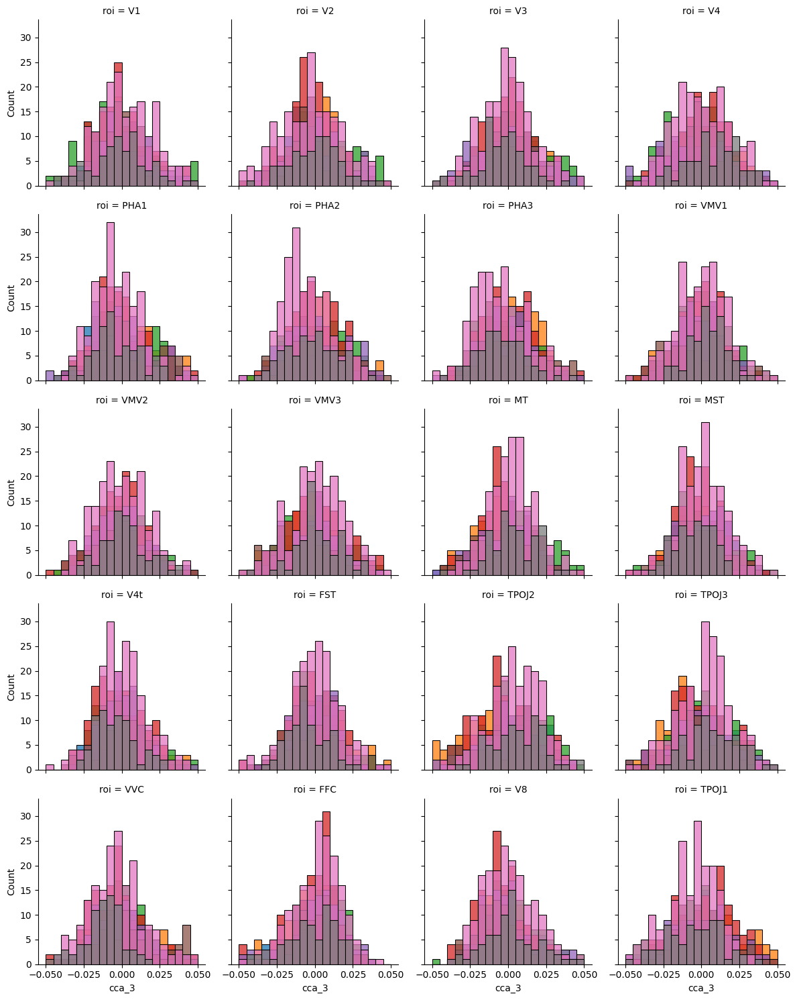

In [373]:
# FacetGrid with CCA1 and CCA2
g = sns.FacetGrid(df_projection_scene, col="roi", hue="scene_cluster", palette="tab10", col_wrap=4)
g.map(sns.histplot, "cca_3", bins=20, binrange=(-0.05, 0.05))
#sns.scatterplot(data=df_projection_scene.query("roi=='V1'"), x="cca_1", y="cca_2", hue="scene_cluster",  palette="tab10")

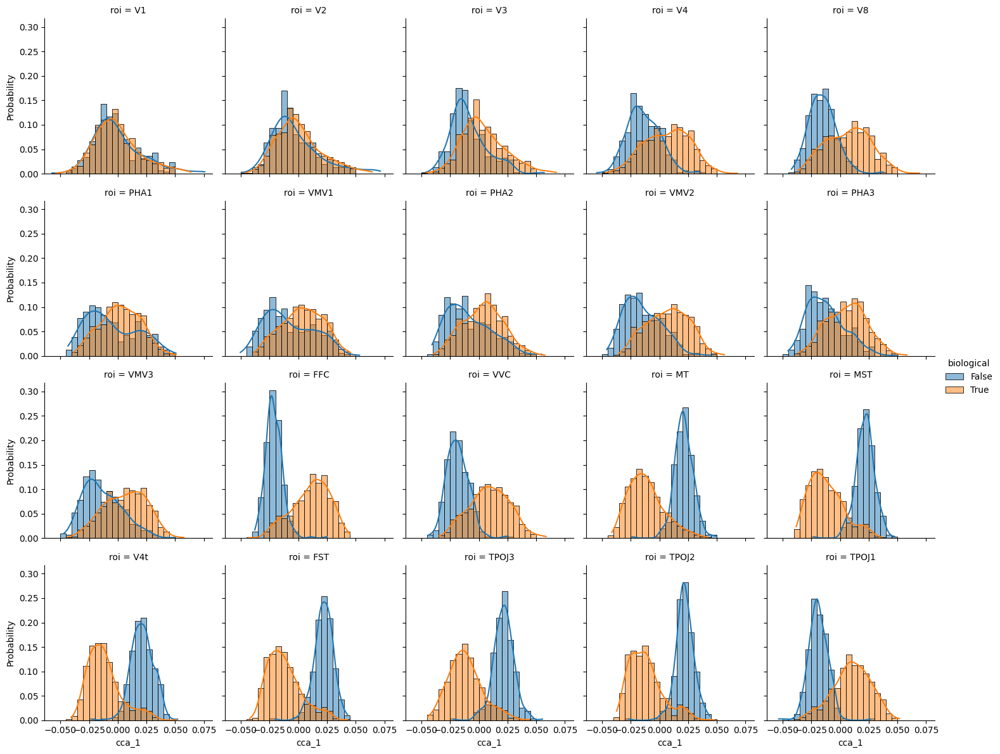

In [400]:
# Make a grid of scatter plots with hue = person, cols = roi, x=cca_1, y=cca_2
col_order = ["V1", "V2", "V3", "V4", "V8", "PHA1", "VMV1","PHA2", "VMV2", "PHA3",  "VMV3", "FFC", "VVC",  "MT", "MST", "V4t", "FST", "TPOJ3", "TPOJ2",  "TPOJ1"]
g = sns.FacetGrid(df_projection_scene, col="roi", hue="biological", col_wrap=5, col_order=col_order)
#g.map(sns.scatterplot, "cca_1", "cca_2")
g.map(sns.histplot, "cca_1", common_bins=True, common_norm=False, stat="probability", kde=True, bins=20, binrange=(-0.05, 0.05))
g.add_legend()
plt.show()

<Axes: xlabel='cca_1', ylabel='cca_2'>

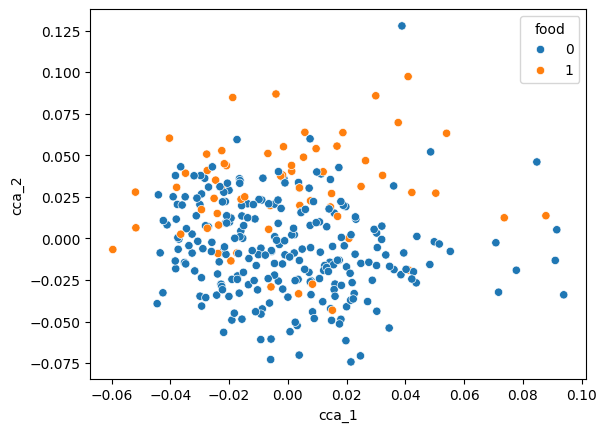

In [390]:
sns.scatterplot(data=df_projection_no_person.query("roi == 'V4t'"), x="cca_1", y="cca_2", hue="food")

In [665]:
df_projection_roi = df_projection_scene.query("roi=='MST'").copy()
# Resize cca_1 and cca_2 to 0-1
df_projection_roi["cca_1"] = (df_projection_roi["cca_1"] - df_projection_roi["cca_1"].min()) / (df_projection_roi["cca_1"].max() - df_projection_roi["cca_1"].min())
df_projection_roi["cca_2"] = (df_projection_roi["cca_2"] - df_projection_roi["cca_2"].min()) / (df_projection_roi["cca_2"].max() - df_projection_roi["cca_2"].min())


palette = ['#1F77B4', '#AEC7E8', '#FF7F0E', '#FFBB78', '#2CA02C', '#98DF8A']

color_mapping = {"sports": palette[0], 
                 'person action': palette[1],
                 'animal': palette[4],
                 'vehicle': palette[5],
                 'Scene': palette[2],
                 'food': palette[3],
                    'unknown': "gray"}




df_projection_roi["image_category"] = "unknown"
df_projection_roi.loc[(df_projection_roi.person == 1), "image_category"] = "person action"
df_projection_roi.loc[(df_projection_roi.person == 0), "image_category"] = "Scene"
df_projection_roi.loc[(df_projection_roi.food==1) & (df_projection_roi.person == 0), "image_category"] = "food"
df_projection_roi.loc[(df_projection_roi.kitchen_x==1) & (df_projection_roi.person == 0), "image_category"] = "food"
df_projection_roi.loc[df_projection_roi.vehicle==1, "image_category"] = "vehicle"
df_projection_roi.loc[df_projection_roi.animal==1, "image_category"] = "animal"
df_projection_roi.loc[df_projection_roi.sports==1, "image_category"] = "sports"
person_action = [34874, 44720, 22886, 40235, 61797, 31028, 56290, 60725, 44107, 18796, 23492, 43950, 31747, 28349, 67252, 46380, 27326, 9722, 45945, 72080, 62365,
                 70232, 55933, 8925, 19933, 53891, 19436, 21197, 6444, 45129]

# food 
# scene  

df_projection_roi.loc[df_projection_roi.nsd_id.isin(person_action), "image_category"] = "person action"

sports = [25602]
df_projection_roi.loc[df_projection_roi.nsd_id.isin(sports), "image_category"] = "sports"
scene = [70764, 7366, 59994, 53070, 34850, 20080 ,22967, 51185, 62209, 20206, 23876, 27287, 30373, 60186, 49944, 4129, 26372, 4667, 20307, 60505, 56154, 67363, 43818, 26720, 63825, 72719]
df_projection_roi.loc[df_projection_roi.nsd_id.isin(scene), "image_category"] = "Scene"
food = [71186, 62960, 57681, 66342, 26909, 67237, 30922]
df_projection_roi.loc[df_projection_roi.nsd_id.isin(food), "image_category"] = "food"
animal = [13230, 42214, 7840]
df_projection_roi.loc[df_projection_roi.nsd_id.isin(animal), "image_category"] = "animal"
# vehicle
vehicle = [28524]
df_projection_roi.loc[df_projection_roi.nsd_id.isin(vehicle), "image_category"] = "vehicle"

df_projection_roi["image_color"] = df_projection_roi["image_category"].map(
    color_mapping
)


(-0.05, 1.05)

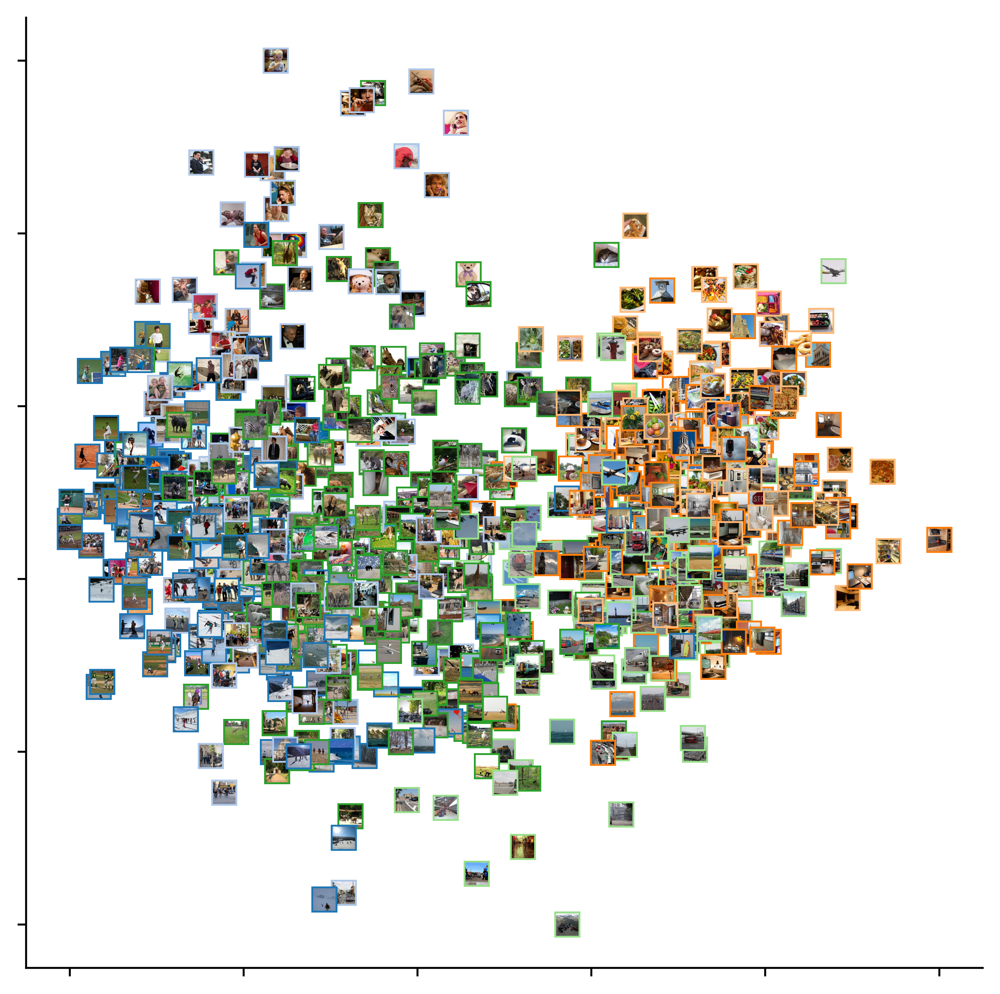

In [652]:


fig, ax = plot_atlas(
    df_projection_roi[["cca_1", "cca_2"]].values,
    nsd_id=df_projection_roi.nsd_id,
    image_size=0.03,
    figsize=(7, 7),
    pixel_size=100,
    dpi=500,
    color=df_projection_roi["image_color"].tolist(),
    outline_width=7,
    #sample=0.1
)
ax.set_xticklabels([])
ax.set_yticklabels([])
ax.set_xlim(-0.05, 1.05)
ax.set_ylim(-0.05, 1.05)

In [661]:
#sns.scatterplot(data=df_projection_roi, x="cca_1", y="cca_2", hue="image_category", palette=color_mapping)
# Plot this scatter in plotly interactive
import plotly.express as px


# 
fig = px.scatter(df_projection_roi, x="cca_1", y="cca_2", color=df_projection_roi["image_category"],
                 color_discrete_map=color_mapping,
                  hover_data=["nsd_id"])
# Equal aspect ratio
fig.update_xaxes(scaleanchor="y", scaleratio=1)
# -1 to 1 axis
fig.update_xaxes(range=[-0.1, 1.1])
fig.update_yaxes(range=[-0.1, 1.1])
fig.show()


In [648]:
# Get matplotlib cmap paired colors
import matplotlib.pyplot as plt
import seaborn as sns

cmap = plt.get_cmap("tab20")
colors = [Color(cmap(i)).to_hex() for i in range(6)]
colors

['#1F77B4', '#AEC7E8', '#FF7F0E', '#FFBB78', '#2CA02C', '#98DF8A']

In [666]:
df_projection_roi_classification = df_projection_roi[["nsd_id", "image_category", "image_color"]].copy()
df_projection_roi_classification["image_category"] = df_projection_roi_classification["image_category"].str.lower().str.replace(" ", "_")
df_projection_roi_classification.to_csv("annotations_shared1000.csv", index=False)

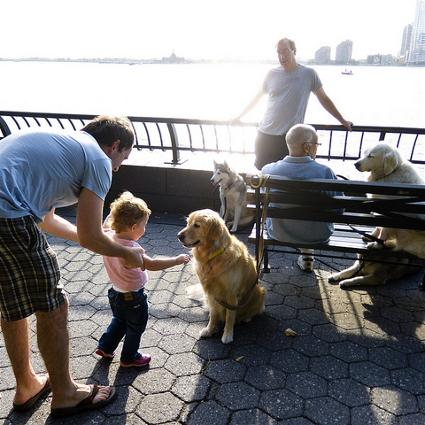

In [614]:
# food
# scene
# animal
# oso 7840

get_image(59079)

  0%|          | 0/907 [00:00<?, ?it/s]

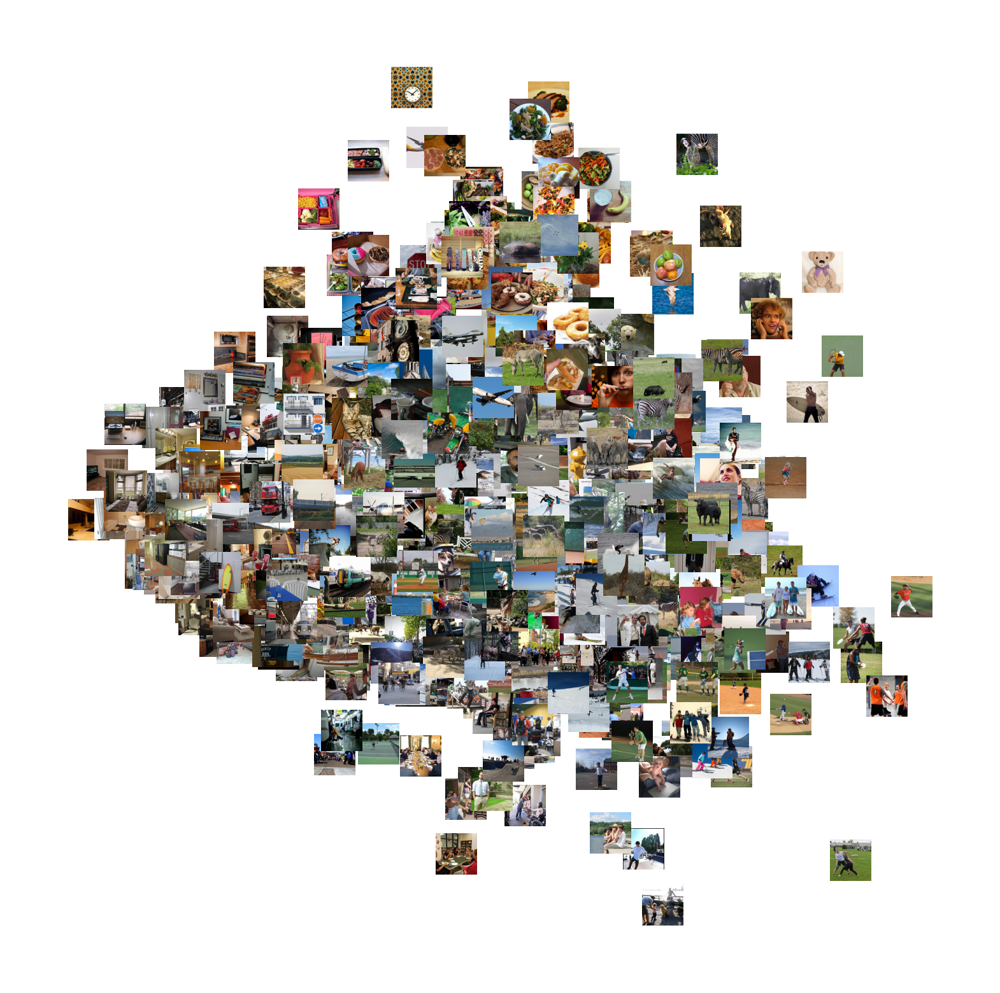

In [395]:
df_projection_roi = df_projection_scene.query("roi=='VMV2'")
fig = plot_atlas(df_projection_roi[['cca_1', "cca_2"]].values, nsd_id=df_projection_roi.nsd_id, image_size=0.05)

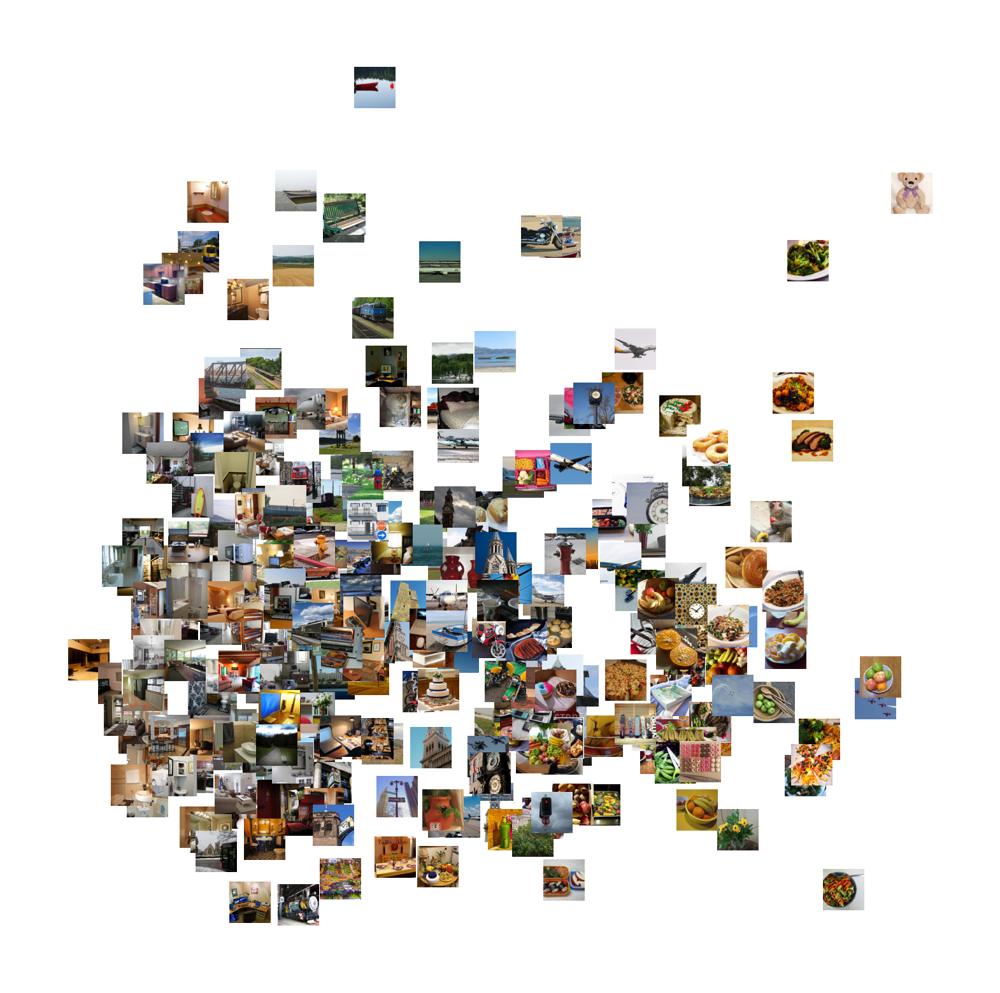

In [393]:
df_projection_roi = df_projection_no_person.query("roi=='VMV2'")
fig = plot_atlas(df_projection_roi[['cca_1', "cca_2"]].values, nsd_id=df_projection_roi.nsd_id, image_size=0.05)

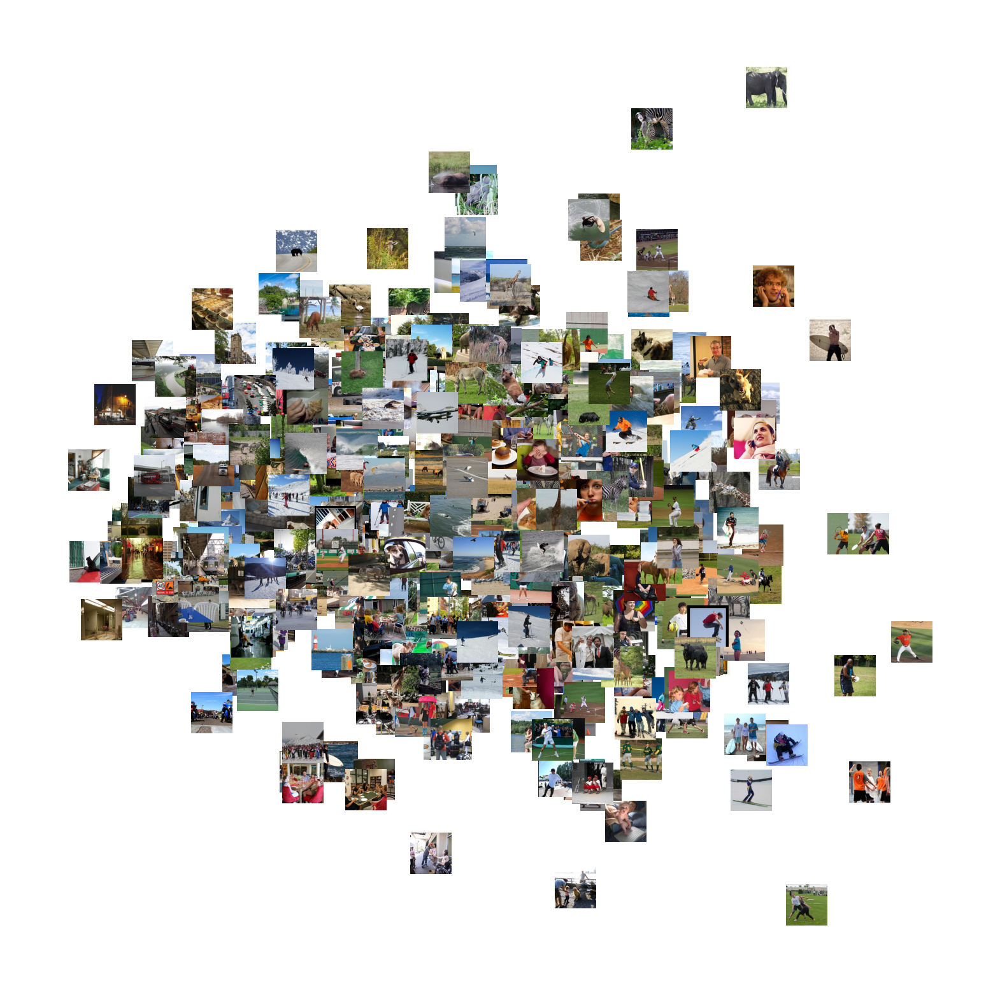

In [392]:
df_projection_roi = df_projection_person.query("roi=='VMV2'")
fig = plot_atlas(df_projection_roi[['cca_1', "cca_2"]].values, nsd_id=df_projection_roi.nsd_id, image_size=0.05)

,nsd_id,cca_1_1,cca_1_2,cca_2_1,cca_2_2,cca_3_1,cca_3_2,cca_4_1,cca_4_2,cca_5_1,cca_5_2,cca_6_1,cca_6_2,cca_7_1,cca_7_2,cca_8_1,cca_8_2
0,2950,-0.001225,-0.014055,0.001453,-0.005766,-0.000240,-0.008348,-0.000684,-0.006168,-0.003673,-0.009203,0.010241,-0.002249,-0.001769,-0.010756,-0.002512,-0.003210
1,2990,-0.004761,-0.007245,-0.004310,-0.001987,-0.006511,0.002206,-0.003468,0.000348,-0.007999,0.002995,0.002317,-0.000049,0.003669,-0.000194,-0.002169,0.002453
2,3049,-0.009295,-0.004797,-0.009256,-0.000549,-0.011776,-0.007806,-0.011683,-0.004524,-0.010568,-0.003525,-0.009374,-0.003182,-0.011675,-0.005220,-0.008309,-0.004538
3,3077,-0.003207,-0.015381,-0.000894,-0.005040,0.003136,-0.013879,0.004207,-0.006302,-0.004019,-0.012401,-0.002851,-0.005464,0.001856,-0.002875,0.000719,-0.008354
4,3146,0.013907,-0.008237,0.007577,0.002551,0.010751,0.000715,0.010939,-0.003186,0.011756,-0.004180,0.009823,0.000677,0.008317,-0.003293,-0.000028,-0.003527
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
902,72312,-0.003236,-0.020590,-0.007275,-0.010426,-0.002171,-0.018875,-0.004937,-0.013383,-0.005173,-0.014236,-0.005003,-0.005675,-0.008613,-0.015677,0.005144,-0.005697
903,72510,0.011448,-0.012824,0.013071,0.003822,0.005268,-0.003985,0.005534,-0.007038,0.013412,-0.012244,0.012194,-0.000656,0.012869,0.006713,0.007103,0.002175
904,72605,0.000993,0.004522,-0.004177,0.003994,-0.004523,-0.002958,0.000423,0.000894,-0.001587,0.003528,0.002431,0.006169,-0.001511,-0.005254,0.005335,0.004729
905,72719,0.010531,-0.003155,0.008279,-0.002364,0.013279,0.004757,0.007991,-0.006474,0.006833,0.004357,0.005079,0.004082,0.004639,-0.004672,0.008238,-0.002215


In [184]:
projection_df

,cca_0_0,cca_0_1,cca_1_0,cca_1_1,cca_2_0,cca_2_1,cca_3_0,cca_3_1,cca_4_0,cca_4_1,cca_5_0,cca_5_1,cca_6_0,cca_6_1,cca_7_0,cca_7_1
0,-0.002657,0.002675,-0.001004,-0.004856,-0.001200,-0.007852,0.001686,-0.002404,-0.001469,-0.007739,-0.006358,-0.003914,-0.006053,0.002630,0.001346,-0.002684
1,0.008163,-0.001910,0.002194,-0.000202,0.011187,-0.001433,0.010003,0.007847,0.000995,0.000049,0.006165,-0.003732,0.002065,0.008381,0.008059,-0.000230
2,-0.004502,-0.008586,-0.001273,-0.009644,-0.006560,-0.012590,-0.005727,-0.000456,0.008790,0.000323,0.002135,-0.014938,-0.002928,-0.003850,-0.001273,-0.007442
3,0.017681,-0.005603,0.015191,-0.008185,0.015437,-0.000191,0.017926,-0.001709,0.016308,0.005727,0.009848,-0.001176,0.013437,0.002725,0.020276,0.003903
4,0.011805,-0.006819,0.008240,-0.013178,0.011992,-0.001856,0.011857,0.008429,0.019190,0.003848,0.014714,0.002172,0.015334,0.001516,0.018267,0.007141
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2183,0.019633,-0.001276,0.004989,-0.007698,0.003902,0.002281,0.003971,0.000963,0.002745,0.007184,0.011557,-0.002243,0.004182,-0.003995,0.011337,0.003027
2184,0.000994,0.000083,-0.006305,-0.000213,-0.003795,-0.004684,-0.002387,-0.002876,-0.008018,0.000310,-0.006202,0.003766,0.004508,-0.007742,0.004533,0.000533
2185,0.011680,0.004170,0.007688,-0.005868,-0.000245,0.001290,0.017309,0.001971,0.011005,0.000502,0.003458,-0.012929,0.004527,0.002906,0.009780,0.003161
2186,-0.004058,0.002728,-0.005217,0.006103,-0.005607,0.002484,-0.008212,0.007793,-0.008720,-0.000304,-0.008279,-0.005447,0.001951,-0.006053,-0.003548,0.001949


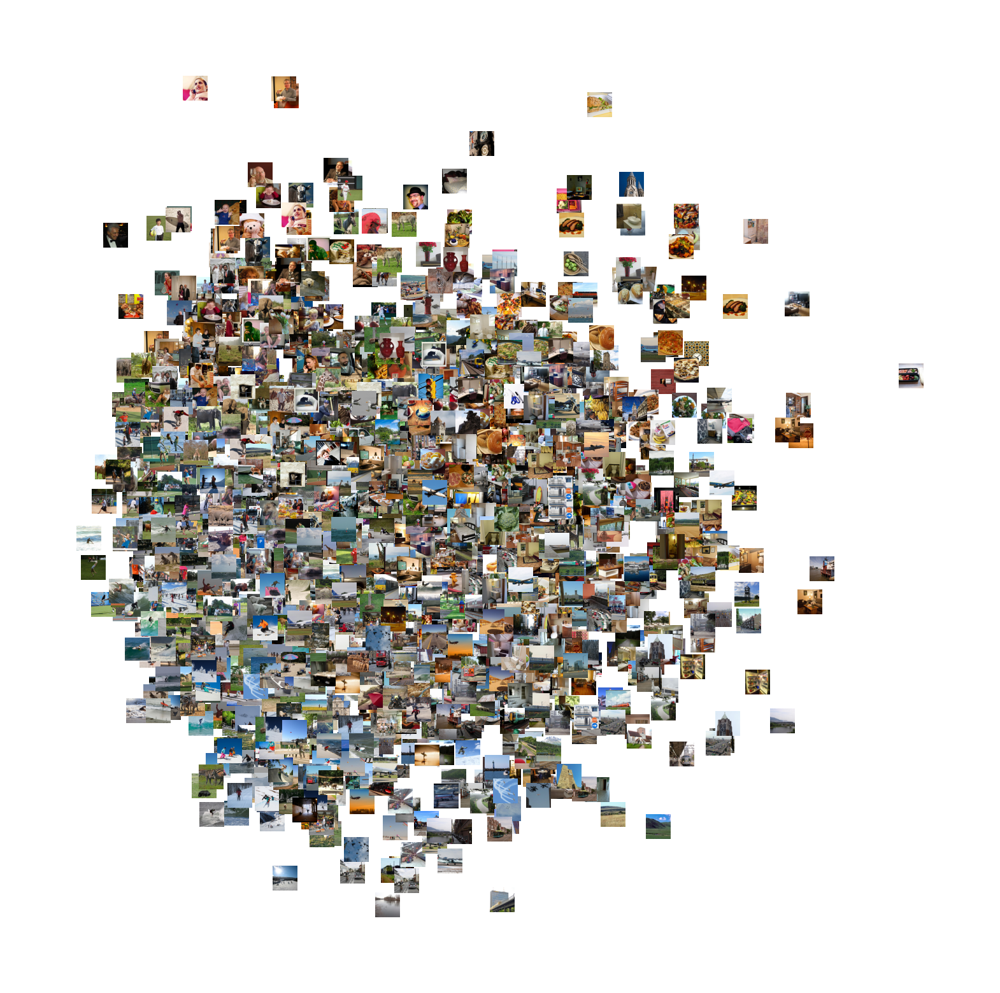

In [169]:
subject_projection

,0,1,2,3,4,5,6,7,8,9,variable
0,-0.000079,0.010127,-0.004766,-0.009520,-0.002769,0.016332,-0.005601,0.000412,-0.004186,0.009006,True
1,0.008656,-0.004422,-0.006055,-0.002421,-0.000414,0.012363,-0.008263,0.005152,0.000156,-0.003032,False
2,-0.005420,-0.009386,0.007272,-0.002818,0.002090,0.007274,-0.003899,-0.005529,-0.008211,0.012219,False
3,0.016393,0.002107,0.012141,0.005038,0.002757,0.010186,0.007957,-0.000233,0.002958,-0.010784,False
4,0.013130,-0.005653,-0.003712,-0.001680,-0.001874,0.005522,0.002155,0.007200,-0.004708,-0.016218,False
...,...,...,...,...,...,...,...,...,...,...,...
2183,0.019612,0.002510,-0.000674,-0.013610,-0.001046,-0.003483,0.008572,-0.012523,0.017368,0.010226,True
2184,-0.005171,0.006656,-0.000428,0.011484,-0.000164,-0.012531,0.006697,-0.000801,0.010861,0.008106,True
2185,0.011072,0.009126,0.024348,-0.010862,0.009689,-0.002133,0.014513,0.024777,0.011036,0.025590,False
2186,-0.007632,0.004592,0.005940,-0.003656,-0.004651,-0.002978,0.005995,-0.000854,-0.000962,0.004452,True


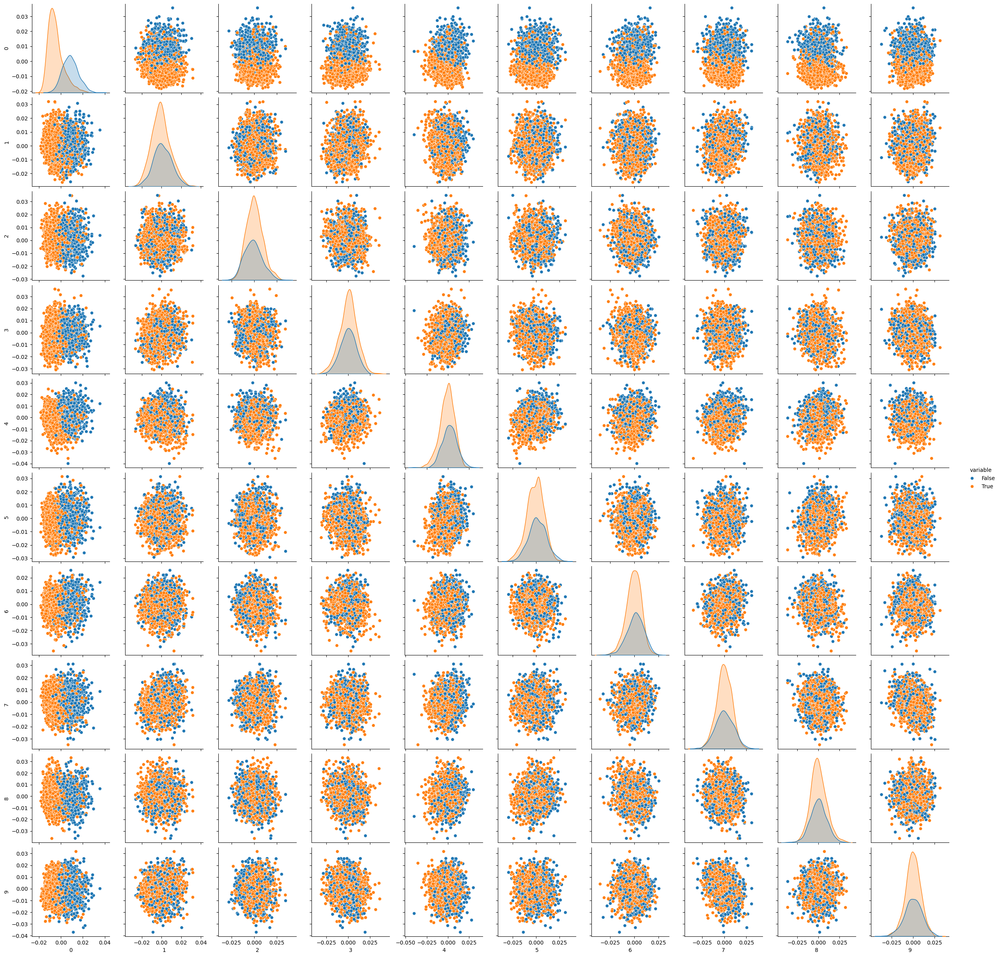

In [153]:
subject = 0
subject_projection = projection[subject]
subject_projection = pd.DataFrame(subject_projection)
subject_projection["variable"] = (df_variables["person"] + df_variables["animal"])!=0
sns.pairplot(subject_projection, hue="variable")

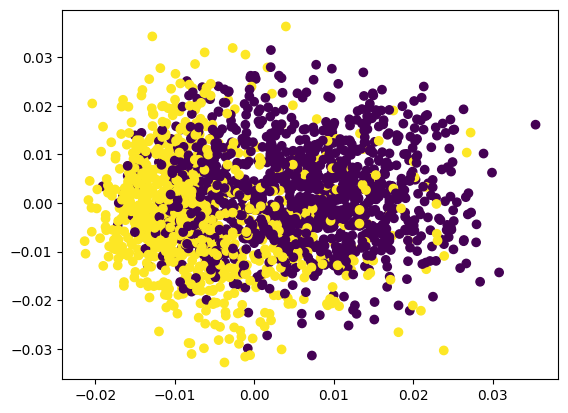

In [93]:
plt.scatter(projection[0][:, 0], projection[0][:, 1], c=df_variables.person)

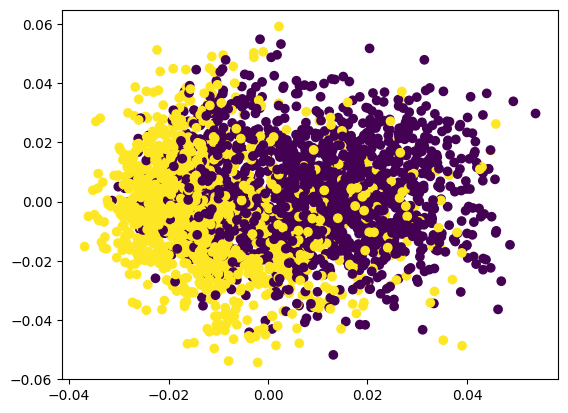

In [81]:
plt.scatter(projection[0][:, 0], projection[0][:, 1], c=df_variables.person)

In [ ]:


for reg in np.linspace(0, 1, 10):
    cca =KMCCA(n_components=1, regs=0.5, kernel="cosine")

    roi = 1
    betas = get_subject_roi(subject=subject, roi=roi)
    betas_session = betas[subject_index]

    a, b = np.quantile(betas_session, [0.005, 0.995])
    betas_session = np.clip(betas_session, a, b).astype(float)
    betas_session = betas_session - betas_session.mean()

    perceptual = df_perceptual.values[nsd_id]

    cca.fit([perceptual[:600], betas_session[:600]])
    x, y = cca.transform([perceptual[600:], betas_session[600:]])
    print(reg, stats.pearsonr(x.ravel(), y.ravel()), x.min(), x.max(), y.min(), y.max())